<a href="https://colab.research.google.com/github/aalbaran/DS5100-2023-08-O/blob/main/DS6050_Project_SciBERT_vs3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#!pip install transformers torch sklearn
import numpy as np
import pandas as pd
import torch
import matplotlib.pyplot as plt
from transformers import BertTokenizer, BertModel
from transformers import pipeline
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from transformers import pipeline
from sklearn.feature_extraction.text import CountVectorizer
import matplotlib.pyplot as plt
%matplotlib inline


#Import gensim, our library for text analysis
import gensim
from gensim.parsing.preprocessing import STOPWORDS
from gensim.corpora.dictionary import Dictionary
from sklearn.feature_extraction.text import CountVectorizer

# Plotting tools
import pyLDAvis
import pyLDAvis.gensim  # don't skip this

import pickle

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning);

import os


In [ ]:
#  Read in pickle file
data_words_bigrams = pd.read_pickle('scied_words_bigrams_V5.pkl')

In [ ]:
# Check length of file
len(data_words_bigrams)

5577

In [ ]:
corpus = [ w for doc in data_words_bigrams for w in doc ]

In [ ]:
from helpers import plot_freq_dist,get_top_n_words,plot_words_freq

Unfiltered Dictionary contains 200776 unique words


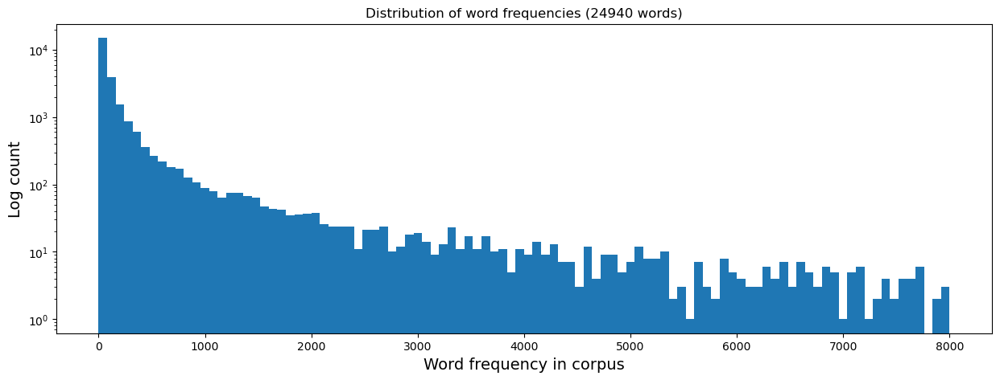

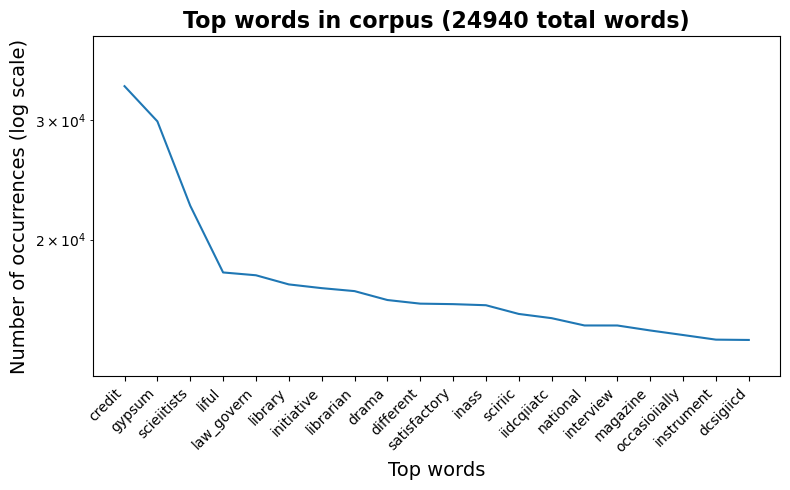

In [ ]:
no_below = 15
no_above = 0.5

id2word_unfiltered_above = gensim.corpora.Dictionary(data_words_bigrams) #Needed for a bug
print("Unfiltered Dictionary contains \033[1m%d\033[0m unique words" % len(id2word_unfiltered_above)) #209780

id2word = gensim.corpora.Dictionary(data_words_bigrams)
id2word.filter_extremes(no_below=no_below, no_above=no_above, keep_n=100000)

#Create BoW
bow_corpus = [id2word.doc2bow(doc) for doc in data_words_bigrams]

[words, freq, ids] = get_top_n_words(corpus, n_top_words=None)

#Get most frequent words from id2word Dictionary
#There is a bug with csf: https://github.com/RaRe-Technologies/gensim/issues/2574
[ids, freq] = zip(*sorted(id2word.cfs.items(), key=lambda x: x[1], reverse=True))
words = [id2word_unfiltered_above[id] for id in ids]  #have to use id2word_unfiltered to retrieve words from ids!!

# Plot distribution
plot_freq_dist(freq, range=[0,8000])
plot_words_freq(words, freq, 20, ylim=None);

# Prepare Your Word Frequency Table:

In [ ]:
word_list1 = []
word_freq1 = []

for i in range(len(id2word)):
    word_list1.append(id2word[ids[i]])
    word_freq1.append(freq[i])

#word_list1
#word_freq1

word_freq = dict(zip(word_list1, word_freq1))
#word_freq

# Load the SciBERT Model:

In [ ]:
# Load the SciBERT model and tokenizer
tokenizer = BertTokenizer.from_pretrained("allenai/scibert_scivocab_uncased")
model = BertModel.from_pretrained("allenai/scibert_scivocab_uncased")

# Embeddings by Word (not weighted by frequency):

# Get Word Embeddings:

In [ ]:
# Function to get word embeddings
def get_word_embedding(word):
    # Tokenize the word and get the input tensor
    inputs = tokenizer(word, return_tensors="pt")

    # Pass the input through the model
    with torch.no_grad():
        outputs = model(**inputs)

    # The embedding of the word is the mean of the token embeddings
    word_embedding = outputs.last_hidden_state.mean(dim=1)  # Mean pooling
    return word_embedding

# Create a dictionary to store the word embeddings
word_embeddings = {}

for word in word_freq:
    word_embeddings[word] = get_word_embedding(word)

# Prepare Data for Clustering:

In [ ]:
# Convert word embeddings to NumPy array for clustering
word_list = list(word_embeddings.keys())
embedding_matrix = np.vstack([word_embeddings[word].numpy() for word in word_list])

# Cluster the Word Embeddings:

In [ ]:
from sklearn.cluster import KMeans

# Number of topics (clusters) you want to discover
n_clusters = 200

# Fit a KMeans model to cluster the words based on their embeddings
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
kmeans.fit(embedding_matrix)

# Get the cluster assignments for each word
word_clusters = {word_list[i]: kmeans.labels_[i] for i in range(len(word_list))}

In [ ]:
# Display the words in each cluster
#for cluster_id in range(n_clusters):
for cluster_id in range(10):
    print(f"Cluster {cluster_id}:")
    cluster_words = [word for word, cluster in word_clusters.items() if cluster == cluster_id]
    print(", ".join(cluster_words))
    print()

Cluster 0:
diversity, aquarium, assimilate, caterpillar, mushroom, reptile, precipitation, wooden, feather, uranium, beetle, leaflet, turtle, microorganism, vegetation, invertebrate, larva, glacier, protoplasm, limestone, meadow, sulphur, pollination, mealworm, grasshopper, neophyte, banana, acidity, lizard, oyster, perennial, insecticide, amphibian, charcoal, clayton, woodland, chimpanzee, terrarium, granite, tadpole, shrub, clover, seaweed, organelle, deforestation, goldfish, pasture, geranium, crayfish, daylight, silkworm, peanut, sedimentary, bromine, carnivore, evergreen, sandstone, bedrock, orchard, fishery, savannah, walnut, topsoil, microcosm, herbivore, proximate, subsistence, arthropod, grazing, peated, hibernate, overpopulation, transpiration, spruce, foodstuff, halogen, chelsea, lettuce, peach, strawberry, preservative, guage, fodder, grabbed, potash, reforestation, flounder, hibernation

Cluster 1:
paper_present, address_issue, great_emphasis, usa_receive, societal_issue, 

In [ ]:
#word_embeddings

# Visualizing Topics

In [ ]:

# Reduce dimensionality of the embeddings to 2D for visualization
pca = PCA(n_components=2)
reduced_embeddings = pca.fit_transform(embedding_matrix)

# Plot the 2D embeddings
plt.figure(figsize=(10, 8))

# Scatter plot with color-coded clusters
for i, word in enumerate(word_list):
    plt.text(reduced_embeddings[i, 0], reduced_embeddings[i, 1], word, fontsize=12)

plt.title("Word Embeddings clustered by SciBERT")
plt.show()


# Weighting Embeddings by Word Frequency:

In [ ]:
# Weight embeddings by frequency
weighted_embeddings = []

for word in word_list:
    # Get the embedding and multiply it by the frequency of the word
    weighted_embedding = word_embeddings[word] * word_freq[word]
    weighted_embeddings.append(weighted_embedding)

# Convert to NumPy array
weighted_embedding_matrix = np.vstack(weighted_embeddings)

# Perform clustering again on the weighted embeddings
kmeans.fit(weighted_embedding_matrix)


/apps/software/standard/core/jupyterlab/3.6.3-py3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


KMeans(n_clusters=200, random_state=42)

In [ ]:
# Get the cluster assignments for each word
word_clusters = {word_list[i]: kmeans.labels_[i] for i in range(len(word_list))}

In [ ]:
# Display the words in each cluster
#for cluster_id in range(n_clusters):
for cluster_id in range(10):
    print(f"Cluster {cluster_id}:")
    cluster_words = [word for word, cluster in word_clusters.items() if cluster == cluster_id]
    print(", ".join(cluster_words))
    print()

Cluster 0:
writing, human_being, im, prin_ciples, conjecture, isolation, welcome, vygotsky, chem, vignette, want_know, ausubel, metacognitive, experi_ences, raise_question, kindergarten, discrete, self_report, maria, engineering_design, acquaint, chem_istry, surely, advisor, human_body, discursive, insert, coverage, hobby, fifth_grade, self_efficacy, wide_variety, learn_cycle, sci_entific, preparation_program, reform_base, elemen_tary, mathe_matics, modi_cation, assure, null_hypothesis, atomic_energy, ence, educa_tional, specialization, newspaper, lederman, logically, ce, booklet, arithmetic, velopment, inquiry_orient, preconception, statistical_analysis, sustainability, string, classical, university_chicago, arrow, sample_size, desk, positive_negative, recitation, dif_ferent, annual_meeting, judging, wouldn, ness, antl, history_philosophy, oi, deem, reviewer, office_education, acceleration, evaluative, empirical_evidence, dialogic, ad, men_woman, motion_picture, supervise, bearing, al